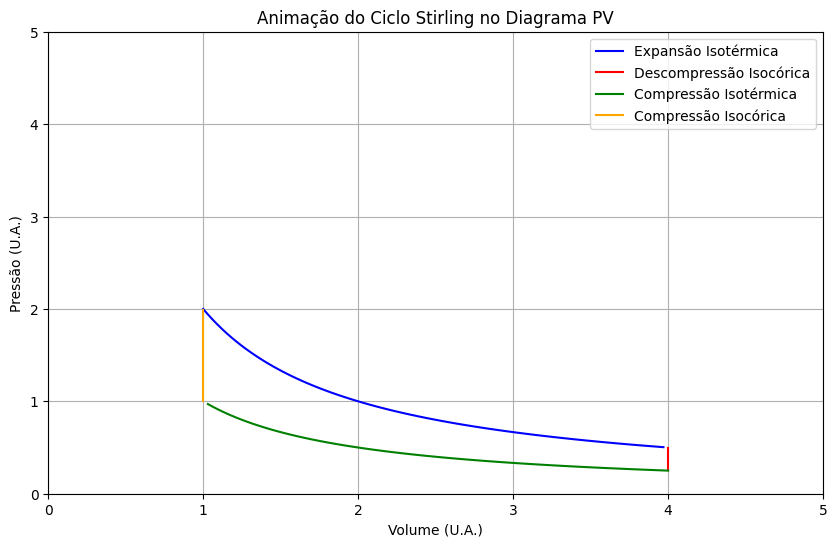

In [1]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

# Definindo os parâmetros do ciclo de Stirling
V1 = V4 = 1.0
V2 = V3 = 4.0
T1 = 2.0

# Gerando os pontos para as curvas do ciclo
V_exp_isotermica = np.linspace(V1, V2, 100)
P_exp_isotermica = T1 / V_exp_isotermica

P2 = T1 / V2
T3 = 1.0
P3 = T3 / V3
V_descomp_isocorica = np.linspace(V2, V3, 100)
P_descomp_isocorica = np.linspace(P2, P3, 100)

V_comp_isotermica = np.linspace(V3, V4, 100)
P_comp_isotermica = T3 / V_comp_isotermica

P4 = T3 / V4
V_comp_isocorica = np.linspace(V4, V1, 100)
P_comp_isocorica = np.linspace(P4, T1 / V1, 100)

# Inicializando as curvas como linhas vazias
fig, ax = plt.subplots(figsize=(10, 6))
ax.set_ylim(0, 5)
ax.set_xlim(0, 5)
ax.set_xlabel('Volume (U.A.)')
ax.set_ylabel('Pressão (U.A.)')
ax.set_title('Animação do Ciclo Stirling no Diagrama PV')

# Inicializando as curvas como linhas vazias
line_exp_isotermica, = ax.plot([], [], 'b', label='Expansão Isotérmica')
line_descomp_isocorica, = ax.plot([], [], 'r', label='Descompressão Isocórica')
line_comp_isotermica, = ax.plot([], [], 'g', label='Compressão Isotérmica')
line_comp_isocorica, = ax.plot([], [], 'orange', label='Compressão Isocórica')

# Adicionando a legenda e a grade
ax.legend()
ax.grid(True)

# Função de inicialização, chamada apenas uma vez
def init():
    line_exp_isotermica.set_data([], [])
    line_descomp_isocorica.set_data([], [])
    line_comp_isotermica.set_data([], [])
    line_comp_isocorica.set_data([], [])
    return line_exp_isotermica, line_descomp_isocorica, line_comp_isotermica, line_comp_isocorica

# Função de animação
def animate(frame):
    # Atualizando os dados das curvas
    if frame < len(V_exp_isotermica):
        line_exp_isotermica.set_data(V_exp_isotermica[:frame], P_exp_isotermica[:frame])
    elif frame < len(V_exp_isotermica) + len(V_descomp_isocorica):
        line_descomp_isocorica.set_data(V_descomp_isocorica[:frame-len(V_exp_isotermica)], P_descomp_isocorica[:frame-len(V_exp_isotermica)])
    elif frame < len(V_exp_isotermica) + len(V_descomp_isocorica) + len(V_comp_isotermica):
        line_comp_isotermica.set_data(V_comp_isotermica[:frame-(len(V_exp_isotermica)+len(V_descomp_isocorica))], P_comp_isotermica[:frame-(len(V_exp_isotermica)+len(V_descomp_isocorica))])
    else:
        line_comp_isocorica.set_data(V_comp_isocorica[:frame-(len(V_exp_isotermica)+len(V_descomp_isocorica)+len(V_comp_isotermica))], P_comp_isocorica[:frame-(len(V_exp_isotermica)+len(V_descomp_isocorica)+len(V_comp_isotermica))])

    return line_exp_isotermica, line_descomp_isocorica, line_comp_isotermica, line_comp_isocorica

# Configurando a animação
total_frames = len(V_exp_isotermica) + len(V_descomp_isocorica) + len(V_comp_isotermica) + len(V_comp_isocorica)
ani = FuncAnimation(fig, animate, frames=total_frames, init_func=init, blit=True, interval=100)

# Exibindo a animação usando JSAnimation
HTML(ani.to_jshtml())

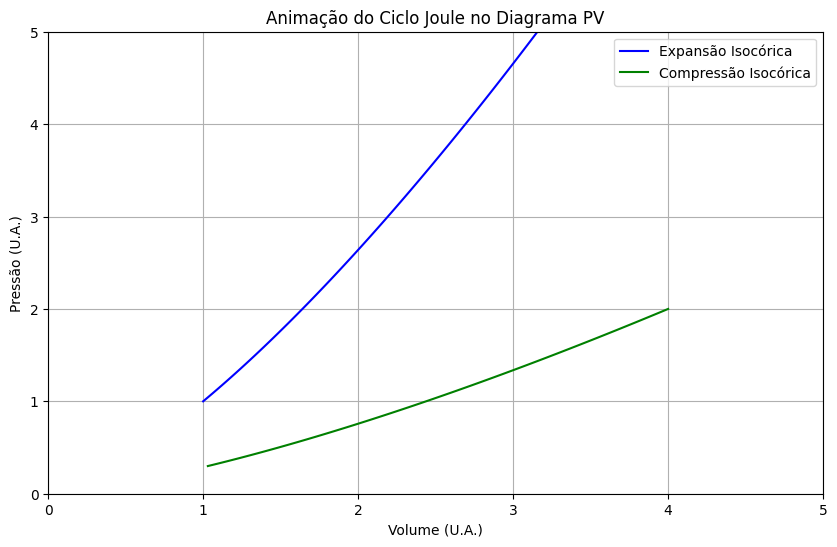

In [2]:
# Definindo os parâmetros do ciclo Joule
T1 = 2.0
P1 = 1.0
T2 = 1.0
P2 = 2.0

# Gerando os pontos para as curvas do ciclo
V_exp_isotermica = np.linspace(V1, V2, 100)
P_exp_isotermica = P1 * np.power(V1 / V_exp_isotermica, -1.4)

V_comp_isotermica = np.linspace(V2, V1, 100)
P_comp_isotermica = P2 * np.power(V2 / V_comp_isotermica, -1.4)

# Inicializando as curvas como linhas vazias
fig, ax = plt.subplots(figsize=(10, 6))
ax.set_ylim(0, 5)
ax.set_xlim(0, 5)
ax.set_xlabel('Volume (U.A.)')
ax.set_ylabel('Pressão (U.A.)')
ax.set_title('Animação do Ciclo Joule no Diagrama PV')

# Inicializando as curvas como linhas vazias
line_exp_isotermica, = ax.plot([], [], 'b', label='Expansão Isocórica')
line_comp_isotermica, = ax.plot([], [], 'g', label='Compressão Isocórica')

# Adicionando a legenda e a grade
ax.legend()
ax.grid(True)

# Função de inicialização, chamada apenas uma vez
def init():
  line_exp_isotermica.set_data([], [])
  line_comp_isotermica.set_data([], [])
  return line_exp_isotermica, line_comp_isotermica

# Função de animação
def animate(frame):
  # Atualizando os dados das curvas
  if frame < len(V_exp_isotermica):
    line_exp_isotermica.set_data(V_exp_isotermica[:frame], P_exp_isotermica[:frame])
  else:
    line_comp_isotermica.set_data(V_comp_isotermica[:frame-len(V_exp_isotermica)], P_comp_isotermica[:frame-len(V_exp_isotermica)])

  return line_exp_isotermica, line_comp_isotermica

# Configurando a animação
total_frames = len(V_exp_isotermica) + len(V_comp_isotermica)
ani = FuncAnimation(fig, animate, frames=total_frames, init_func=init, blit=True, interval=100)

# Exibindo a animação usando JSAnimation
HTML(ani.to_jshtml())

In [3]:
import requests

def fetch_data():
    # URL da API
    api_url = 'https://api.adviceslip.com/advice'

    try:
        # Fazendo a requisição GET para a API
        response = requests.get(api_url)

        # Verificando se a requisição foi bem-sucedida (código 200)
        if response.status_code == 200:
            # Extraindo os dados JSON da resposta
            data = response.json()

            # Exibindo os dados (substitua por sua lógica desejada)
            print(data)
        else:
            print('Erro ao obter dados. Código de status:', response.status_code)
    except Exception as e:
        print('Erro durante a requisição:', e)

# Chamando a função para obter dados
fetch_data()



{'slip': {'id': 160, 'advice': 'Enjoy a little nonsense now and then.'}}
